<a href="https://colab.research.google.com/github/pedromirsky/ood_proyecto_final/blob/main/OODEEL_DATASETS_VS_MNIST_MAHALANOBIS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports, funciones y pip install

In [4]:
!pip uninstall -y tensorflow keras
!pip install tensorflow==2.15 keras==2.15
!pip install tensorflow-probability==0.23.0 tensorflow_datasets==4.9.4
!pip install oodeel

Found existing installation: tensorflow 2.15.0
Uninstalling tensorflow-2.15.0:
  Successfully uninstalled tensorflow-2.15.0
Found existing installation: keras 2.15.0
Uninstalling keras-2.15.0:
  Successfully uninstalled keras-2.15.0
  Using cached tensorflow-2.15.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (4.4 kB)
  Using cached keras-2.15.0-py3-none-any.whl.metadata (2.4 kB)
Using cached tensorflow-2.15.0-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (475.2 MB)
Using cached keras-2.15.0-py3-none-any.whl (1.7 MB)
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.15.0 which is incompatible.


  Using cached tensorflow_datasets-4.9.4-py3-none-any.whl.metadata (9.2 kB)
Using cached tensorflow_datasets-4.9.4-py3-none-any.whl (5.1 MB)


Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 3070, in _dep_map
    return self.__dep_map
  File "/usr/local/lib/python3.10/dist-packages/pip/_vendor/pkg_resources/__init__.py", line 2863, in __getattr__
    raise AttributeError(attr)
AttributeError: _DistInfoDistribution__dep_map

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/base_command.py", line 179, in exc_logging_wrapper
    status = run_func(*args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/req_command.py", line 67, in wrapper
    return func(self, options, args)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 447, in run
    conflicts = self._determine_conflicts(to_install)
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/install.py", line 5

In [1]:
import oodeel
import tensorflow as tf
import keras
import sys
import tensorflow_probability as tfp
import tensorflow_datasets as tfds
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import os
from oodeel.datasets import OODDataset
from oodeel.eval.metrics import bench_metrics
from oodeel.eval.plots import plot_ood_scores, plot_roc_curve, plot_2D_features
from oodeel.datasets.tf_data_handler import TFDataHandler
from oodeel.methods import MLS
from oodeel.methods import Mahalanobis
import numpy as np
import plotly.graph_objs as go
import seaborn as sns
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc, precision_recall_curve

print(f"TensorFlow version: {tf.__version__}")
print(f"Keras version: {keras.__version__}")
print(f"Python version: {sys.version}")
print(f"TensorFlow Probability version: {tfp.__version__}")
print(f"TensorFlow Datasets version: {tfds.__version__}")
print(f"Oodeel version: {oodeel.__version__}")

TensorFlow version: 2.15.0
Keras version: 2.15.0
Python version: 3.10.12 (main, Sep 11 2024, 15:47:36) [GCC 11.4.0]
TensorFlow Probability version: 0.23.0
TensorFlow Datasets version: 4.9.4
Oodeel version: 0.2.0


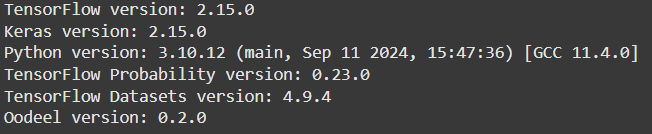

In [2]:
#pedro.mirsky@hospitalitaliano.org.ar
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Datasets

## Funciones

###Extraer info descriptiva de las imágenes

In [3]:
from PIL import Image
import numpy as np
import pandas as pd
import os

def extract_image_info(df, file_name_column, images_path, file_extension="", num_images=None):
    """
    Extrae información descriptiva de las imágenes listadas en un DataFrame.

    Args:
        df (pd.DataFrame): DataFrame que contiene las rutas de las imágenes.
        file_name_column (str): Nombre de la columna con los nombres de los archivos de imagen.
        images_path (str): Ruta de la carpeta donde están las imágenes.
        file_extension (str, optional): Extensión del archivo (por ejemplo, ".jpg", ".png"). Por defecto es "".
        num_images (int, optional): Número máximo de imágenes a procesar. Si es None, procesa todas.

    Returns:
        pd.DataFrame: DataFrame con la información descriptiva de cada imagen.
    """
    # Construir las rutas de las imágenes
    if file_extension:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path, x + file_extension))
    else:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path, x))

    # Limitar el número de imágenes a procesar
    if num_images is not None:
        df = df.head(num_images)

    # Lista para almacenar la información de las imágenes
    image_info_list = []

    # Iterar sobre cada imagen en el DataFrame
    for index, row in df.iterrows():
        image_path = row['image_path']
        try:
            # Abrir la imagen usando Pillow
            with Image.open(image_path) as img:
                # Convertir la imagen a un array de numpy
                img_array = np.array(img)

                # Obtener información descriptiva
                dimensions = img_array.shape  # Dimensiones de la imagen
                min_value = img_array.min()   # Valor mínimo en la imagen
                max_value = img_array.max()   # Valor máximo en la imagen
                data_type = img_array.dtype   # Tipo de datos

                # Guardar la información en la lista
                image_info_list.append({
                    'image_path': image_path,
                    'dimensions': dimensions,
                    'min_value': min_value,
                    'max_value': max_value,
                    'data_type': data_type
                })
        except Exception as e:
            # Manejar excepciones si no se puede abrir la imagen
            print(f"Error al abrir la imagen {image_path}: {e}")

    # Convertir la lista a un DataFrame de pandas
    df_image_info = pd.DataFrame(image_info_list)

    return df_image_info


### Crear dataset tf y visualizar imágenes opcionalmente

In [4]:
import os
import tensorflow as tf
import matplotlib.pyplot as plt

def prepare_dataset(df, images_path_folder, file_name_column="name", label_column=None, label_map=None, resize_shape=(224, 224), normalize=True,
                    transpose=True, display_samples=False, num_display_samples=27, remove_labels=False, file_extension=""):
    """
    Función para preparar un tf.data.Dataset a partir de un DataFrame y configurar varias opciones.

    Args:
        df (pd.DataFrame): DataFrame que contiene los nombres de los archivos y etiquetas.
        images_path_folder (str): Ruta de la carpeta donde se encuentran las imágenes.
        file_name_column (str, optional): Nombre de la columna con los nombres de los archivos.
        label_column (str, optional): Nombre de la columna con las etiquetas. Si es None, no se usará etiqueta.
        label_map (dict, optional): Diccionario para mapear etiquetas a valores numéricos.
        resize_shape (tuple, optional): Tamaño al que se redimensionarán las imágenes.
        normalize (bool, optional): Si True, normaliza los valores de los píxeles entre 0 y 1.
        transpose (bool, optional): Si True, reordena las dimensiones de las imágenes a (3, altura, ancho).
        display_samples (bool, optional): Si True, muestra algunas imágenes del dataset con sus etiquetas.
        num_display_samples (int, optional): Número de muestras a mostrar si display_samples es True.
        remove_labels (bool, optional): Si True, crea un dataset sin etiquetas, solo con imágenes.
        file_extension (str, optional): Extensión de archivo a añadir a los nombres (por ejemplo, ".jpg" o ".png").
                                        Si es una cadena vacía, no se añadirá ninguna extensión.

    Returns:
        tf.data.Dataset: Dataset preparado según las configuraciones.
    """
    # Añadir la extensión a los nombres de archivo para construir el path completo de cada imagen
    if file_extension:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path_folder, x + file_extension))
    else:
        df['image_path'] = df[file_name_column].apply(lambda x: os.path.join(images_path_folder, x))

    # Convertir etiquetas a formato numérico si se especifica un label_map
    if label_column and label_map:
        df['label'] = df[label_column].map(label_map)
    elif label_column:
        df['label'] = df[label_column]

    # Definir función de procesamiento de imágenes
    def process_image(image_path, label=None):
        image = tf.io.read_file(image_path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, resize_shape)  # Ajustar tamaño de la imagen
        if transpose:
            image = tf.transpose(image, [2, 0, 1])  # Reordenar las dimensiones si es necesario
        if normalize:
            image /= 255.0  # Normalizar los valores de los píxeles
        return (image, tf.cast(label, tf.int32)) if label is not None else image

    # Crear el tf.data.Dataset con o sin etiquetas según `remove_labels`
    if remove_labels:
        dataset = tf.data.Dataset.from_tensor_slices(df['image_path'].values)
        dataset = dataset.map(lambda path: tf.py_function(process_image, [path], [tf.float32]))
    else:
        paths = df['image_path'].values
        labels = df['label'].values if label_column else [None] * len(paths)
        dataset = tf.data.Dataset.from_tensor_slices((paths, labels))
        dataset = dataset.map(lambda path, label: tf.py_function(process_image, [path, label], [tf.float32, tf.int32]))

    # Mostrar muestras si se especifica `display_samples`
    if display_samples:
        plt.figure(figsize=(20, 20))
        for i, (image_path, label) in enumerate(zip(paths[:num_display_samples], labels[:num_display_samples])):
            image, _ = process_image(image_path, label)
            title = f'{df[file_name_column].iloc[i]}: {"Malignant" if label == 1 else "Benign"}'

            rows = (num_display_samples + 4) // 5
            ax = plt.subplot(rows, 5, i + 1)
            plt.imshow(tf.transpose(image, [1, 2, 0]).numpy() if transpose else image.numpy())
            plt.title(title)
            plt.axis('off')

    return dataset


### Display Pred vs True

In [5]:
def display_predictions(dataset, predictions, num_images, threshold = 0.5):

    predicted_labels = (predictions > threshold).astype(int)

    # Obtener las etiquetas reales
    true_labels = []
    for _, label in dataset:
        true_labels.extend(label.numpy())
    true_labels = np.array(true_labels)

    plt.figure(figsize=(20, 20))
    count = 0
    for images, labels in dataset.take((num_images + 31) // 32):  # Ajustar el número de batches a tomar
        for i in range(images.shape[0]):  # Iterar sobre el batch
            if count >= num_images:
                break
            rows = (num_images + 4) // 5  # Calcular el número de filas necesario
            ax = plt.subplot(rows, 5, count + 1)
            image = tf.transpose(images[i], [1, 2, 0]).numpy()  # Reordenar las dimensiones de nuevo para la visualización
            plt.imshow(image)
            pred_label = "Malignant" if predictions[count] == 1 else "Benign"
            true_label = "Malignant" if true_labels[count] == 1 else "Benign"
            plt.title(f'Pred: {pred_label}\nTrue: {true_label}')
            plt.axis('off')
            count += 1


### Obtener plots con Métricas, Confusion Matriz, Curvas ROC, Pr-Rec

In [6]:
def evaluate_model_performance(dataset, predictions, threshold=0.5):
    """
    Evalúa el rendimiento de un modelo utilizando un dataset y las predicciones generadas, mostrando varias métricas.

    Args:
        dataset (tf.data.Dataset): Dataset en lotes con etiquetas reales.
        predictions (np.array): Predicciones del modelo, en formato de probabilidad.
        threshold (float): Umbral para convertir probabilidades en etiquetas binaras.

    Returns:
        None: Imprime métricas y muestra gráficos de rendimiento.
    """
    # Obtener las etiquetas reales del dataset
    true_labels = []
    for _, label in dataset:
        true_labels.extend(label.numpy())
    true_labels = np.array(true_labels)

    # Convertir las predicciones en etiquetas binarias
    predicted_labels = (predictions > threshold).astype(int)

    # Calcular métricas de rendimiento
    accuracy = accuracy_score(true_labels, predicted_labels)
    conf_matrix = confusion_matrix(true_labels, predicted_labels)
    class_report = classification_report(true_labels, predicted_labels, target_names=['Benign', 'Malignant'])

    print(f'Accuracy: {accuracy}')
    print('Confusion Matrix:')
    print(conf_matrix)
    print('Classification Report:')
    print(class_report)

    # Curva ROC y AUC
    fpr, tpr, thresholds_roc = roc_curve(true_labels, predictions)
    roc_auc = auc(fpr, tpr)

    # Curva Precision-Recall y AUC
    precision, recall, thresholds_pr = precision_recall_curve(true_labels, predictions)
    pr_auc = auc(recall, precision)

    # Gráfico interactivo ROC con Plotly
    roc_trace = go.Scatter(x=fpr, y=tpr, mode='lines', name='ROC curve (area = %0.2f)' % roc_auc,
                           text=[f'Threshold: {t:.2f}' for t in thresholds_roc],
                           hoverinfo="text+x+y")
    roc_layout = go.Layout(
        title="ROC Curve",
        xaxis=dict(title="False Positive Rate"),
        yaxis=dict(title="True Positive Rate"),
        shapes=[dict(type='line', x0=0, y0=0, x1=1, y1=1, line=dict(dash='dash'))]
    )
    fig_roc = go.Figure(data=[roc_trace], layout=roc_layout)
    fig_roc.show()

    # Gráfico interactivo Precision-Recall con Plotly
    pr_trace = go.Scatter(x=recall, y=precision, mode='lines', name='Precision-Recall curve',
                          text=[f'Threshold: {t:.2f}' for t in thresholds_pr],
                          hoverinfo="text+x+y")
    pr_layout = go.Layout(
        title="Precision-Recall Curve",
        xaxis=dict(title="Recall"),
        yaxis=dict(title="Precision")
    )
    fig_pr = go.Figure(data=[pr_trace], layout=pr_layout)
    fig_pr.show()

    # Matriz de confusión con seaborn
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", cbar=False,
                xticklabels=['Predicted Benign', 'Predicted Malignant'],
                yticklabels=['Actual Benign', 'Actual Malignant'])
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title("Confusion Matrix")
    plt.show()

    # Imprimir AUCs
    print(f'AUC (ROC): {roc_auc}')
    print(f'Precision-Recall AUC: {pr_auc}')

### Convertir 4 channels a RGB (3 channels)

In [7]:
def convert_to_rgb_and_jpg(df, file_name_column, images_path, output_path):
    """
    Convierte imágenes a RGB (si tienen 4 canales) y las guarda como .jpg.

    Args:
        df (pd.DataFrame): DataFrame que contiene las rutas de las imágenes.
        file_name_column (str): Nombre de la columna con los nombres de los archivos de imagen.
        images_path (str): Ruta de la carpeta donde están las imágenes.
        output_path (str, optional): Ruta de la carpeta donde guardar las imágenes convertidas.
                                     Si es None, sobrescribe las imágenes originales.

    Returns:
        None
    """
    # Crear carpeta de salida si se especifica
    if output_path and not os.path.exists(output_path):
        os.makedirs(output_path)

    for index, row in df.iterrows():
        image_name = row[file_name_column]
        input_path = os.path.join(images_path, image_name)

        try:
            with Image.open(input_path) as img:
                # Convertir a RGB si tiene 4 canales (RGBA)
                if img.mode == 'RGBA':
                    img = img.convert('RGB')
                    print(f"Convertida a RGB: {image_name}")
                elif img.mode != 'RGB':
                    img = img.convert('RGB')
                    print(f"Convertida a RGB (de otro modo): {image_name}")

                # Definir nuevo nombre con extensión .jpg
                new_name = os.path.splitext(image_name)[0] + ".jpg"
                save_path = os.path.join(output_path if output_path else images_path, new_name)

                # Guardar como .jpg
                img.save(save_path, "JPEG")
                print(f"Guardada como .jpg: {save_path}")
        except Exception as e:
            print(f"Error al procesar la imagen {input_path}: {e}")


## Paths:

General

In [8]:
ID_SETS_PATH_IUHI = "/content/drive/MyDrive/Tesis/ID sets"
OOD_SETS_PATH_IUHI = "/content/drive/MyDrive/Tesis/OOD sets"

Específicos

In [9]:
#Train
#Fitzpatrick17k
FITZPATRICK17K_IMAGES_PATH = "/Fitzpatrick17k/images"
FITZPATRICK17K_CSV_TRAIN_PATH = "/Fitzpatrick17k/filtered_fitz_train.csv"
FITZPATRICK17K_CSV_TEST_PATH = "/Fitzpatrick17k/filtered_fitz_test.csv"

#PADUFES
PAD_UFES_IMAGES_PATH = "/PAD_UFES/images"
PAD_UFES_CSV_TRAIN_PATH = "/PAD_UFES/PAD_UFES_train.csv"

#ISIC
ISIC_IMAGES_PATH = "/ISIC/images"
ISIC_CSV_TRAIN_PATH = "/ISIC/ISIC_train.csv"


# Test
#Consumer AI
CONSUMER_AI_IMAGES_PATH = "/Consumer AI/images"
CONSUMER_AI_CSV_TEST_PATH = "/Consumer AI/Consumer AI - prediccionesconsumerai.csv"

#DDI
DDI_IMAGES_PATH = "/DDI/images"
DDI_CSV_TEST_PATH = "/DDI/Stanford - prediccionesstanford_28Feb.csv"

#Institucional
INSTITUCIONAL_IMAGES_PATH = "/Institucional/images"
INSTITUCIONAL_CSV_TEST_PATH = "/Institucional/Institucional - prediccionesTestA.csv"


## Train: Fitz

In [10]:
images_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_CSV_TRAIN_PATH

df_train_fitz = pd.read_csv(csv_path)
print(f"tamaño del dataset: {len(df_train_fitz)}")
df_train_fitz.head()

tamaño del dataset: 1951


,Unnamed: 0,img_path,label
0,1255,c50113547f82a9ad4d3ce4dc0972a698.jpg,malignant
1,1775,e28cbb701b1b2ff727c3c7aba01fe6ff.jpg,malignant
2,2339,fa60f299be44300e85109f587aebfbb3.jpg,malignant
3,2625,4914fa9dae16b9762acae30d0349ad85.jpg,malignant
4,433,ad2b7dbf614fefe443c43c66aa8a9c01.jpg,benign


###Reviso imágenes

In [11]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_train_fitz, file_name_column = "img_path", images_path = images_path, file_extension = "", num_images = 30)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(366, 484, 3)",0,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(389, 456, 3)",0,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(192, 293, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(377, 470, 3)",4,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(369, 480, 3)",0,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(919, 1157, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(192, 280, 3)",0,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(362, 386, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(399, 603, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(531, 769, 3)",0,255,uint8


### Convierto a tf (+ display opcional)

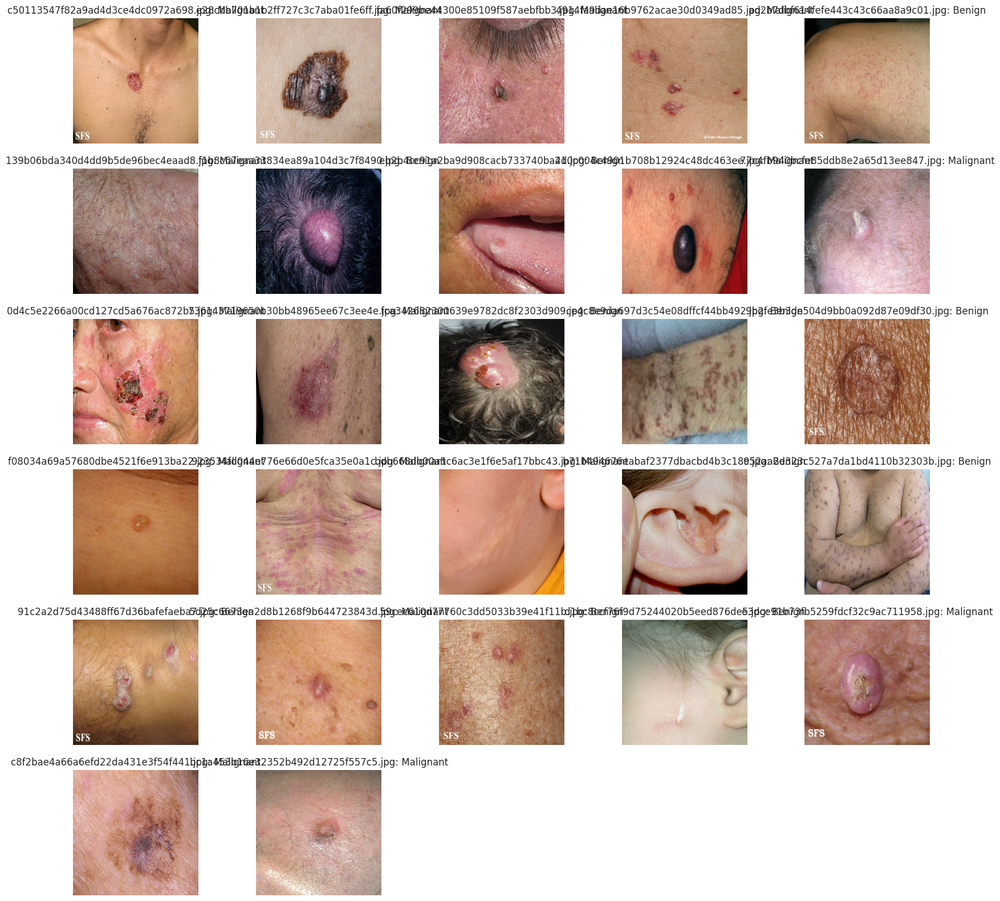

In [12]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_fitz_train = prepare_dataset(df_train_fitz, images_path, file_name_column = "img_path", label_column='label', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


## Train: ISIC

In [13]:
images_path = ID_SETS_PATH_IUHI + ISIC_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + ISIC_CSV_TRAIN_PATH

df_train_ISIC = pd.read_csv(csv_path)
print(f"tamaño del dataset: {len(df_train_ISIC)}")
df_train_ISIC.head()

tamaño del dataset: 1616


,isic_id,attribution,copyright_license,age_approx,anatom_site_general,benign_malignant,concomitant_biopsy,dermoscopic_type,diagnosis,diagnosis_1,...,diagnosis_confirm_type,family_hx_mm,fitzpatrick_skin_type,image_type,lesion_id,patient_id,personal_hx_mm,pixels_x,pixels_y,sex
0,ISIC_6230191,Hospital Italiano de Buenos Aires,CC-BY,25.0,anterior torso,malignant,True,contact polarized,melanoma,Malignant,...,histopathology,NaN,II,dermoscopic,IL_8124990,IP_8542863,True,640,480,male
1,ISIC_4485929,Hospital Italiano de Buenos Aires,CC-BY,65.0,anterior torso,benign,False,contact polarized,seborrheic keratosis,Benign,...,NaN,NaN,I,dermoscopic,IL_1921228,IP_9326183,True,2448,2448,female
2,ISIC_3079785,Hospital Italiano de Buenos Aires,CC-BY,45.0,lower extremity,benign,True,contact polarized,nevus,Benign,...,histopathology,False,II,dermoscopic,IL_3797557,IP_4906546,False,640,480,male
3,ISIC_9677008,Hospital Italiano de Buenos Aires,CC-BY,30.0,posterior torso,malignant,True,contact polarized,melanoma,Malignant,...,histopathology,NaN,II,dermoscopic,IL_3556705,IP_5493434,True,1409,2900,female
4,ISIC_9129115,Hospital Italiano de Buenos Aires,CC-BY,75.0,posterior torso,benign,True,NaN,actinic keratosis,Indeterminate,...,histopathology,NaN,II,clinical: overview,IL_2485486,IP_8947694,NaN,498,1026,female


###Reviso imágenes

In [14]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_train_ISIC, file_name_column = "isic_id", images_path = images_path, file_extension = ".jpg", num_images = 30)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(480, 640, 3)",2,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(2448, 2448, 3)",0,246,uint8
2,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(480, 640, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(2900, 1409, 3)",2,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(1026, 498, 3)",0,243,uint8
5,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(1960, 4032, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(2202, 1071, 3)",29,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(4032, 1960, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(4032, 1960, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/ISIC/imag...,"(1960, 4032, 3)",0,243,uint8


### Convierto a tf (+ display opcional)

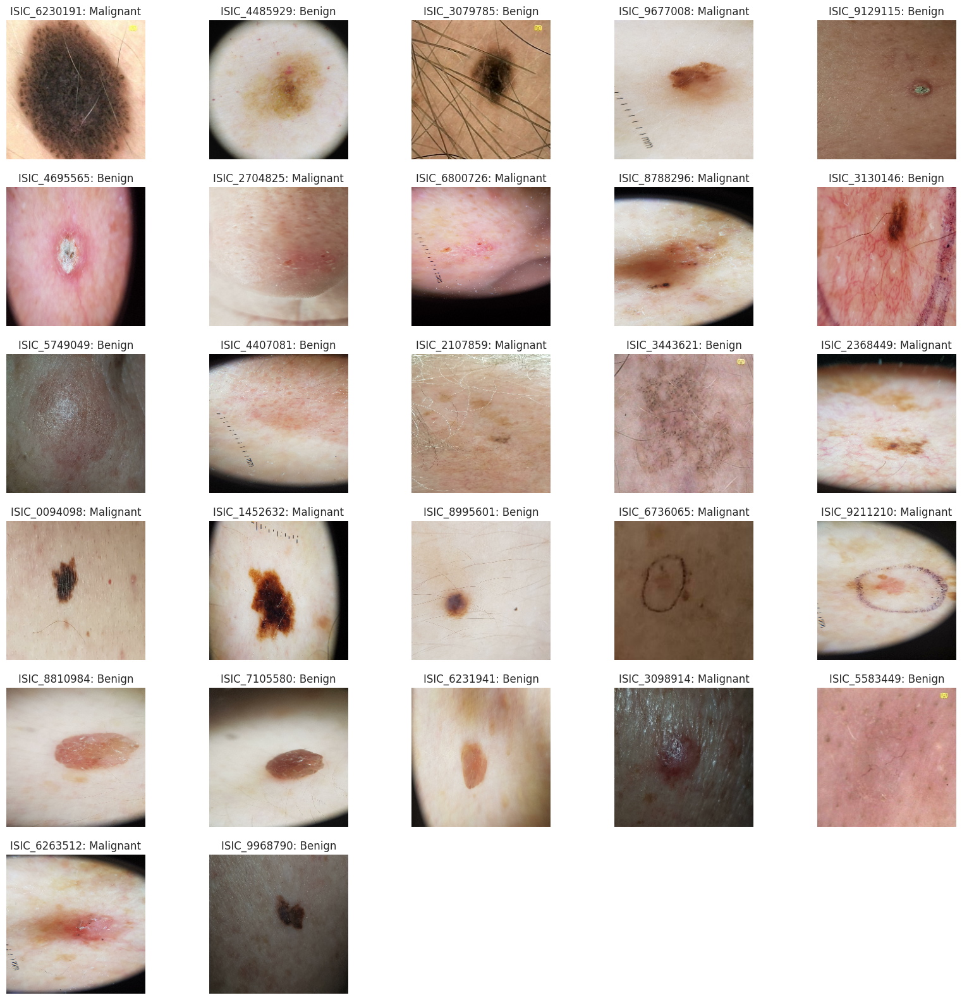

In [15]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_ISIC_train = prepare_dataset(df_train_ISIC, images_path, file_name_column = "isic_id", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension=".jpg")


## Train: PAD_UFES

In [16]:
images_path = ID_SETS_PATH_IUHI + PAD_UFES_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + PAD_UFES_CSV_TRAIN_PATH

df_train_PAD_UFES = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_train_PAD_UFES)}")
df_train_PAD_UFES['name'] = df_train_PAD_UFES['img_id'].str.replace('.png', '.jpg') # a diferencia del resto acá proceso así porque está en .png en el df (igual en carpeta son .jpg)

# Mapeo de diagnósticos a "benign" o "malignant"
diagnostic_map = {
    "BCC": "malignant",
    "MEL": "malignant",
    "SCC": "malignant",
    "ACK": "benign",
    "NEV": "benign",
    "SEK": "benign"
}

# Crear la nueva columna "benign_malignant" en el DataFrame
df_train_PAD_UFES["benign_malignant"] = df_train_PAD_UFES["diagnostic"].map(diagnostic_map)

# Verificar los primeros registros para asegurarse de que la columna se ha agregado correctamente
df_train_PAD_UFES[["name", "benign_malignant", "diagnostic", "benign_malignant"]].head()

tamaño del dataset: 2298


,name,benign_malignant,diagnostic,benign_malignant
0,PAT_1516_1765_530.jpg,benign,NEV,benign
1,PAT_46_881_939.jpg,malignant,BCC,malignant
2,PAT_1545_1867_547.jpg,benign,ACK,benign
3,PAT_1989_4061_934.jpg,benign,ACK,benign
4,PAT_684_1302_588.jpg,malignant,BCC,malignant


###Reviso imágenes

In [17]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_train_PAD_UFES, file_name_column = "name", images_path = images_path, file_extension = "", num_images = 30)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1089, 1089, 3)",10,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1325, 1325, 3)",0,231,uint8
2,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(640, 640, 3)",29,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(2117, 2118, 3)",46,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(896, 896, 3)",19,254,uint8
5,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(499, 499, 3)",24,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(514, 514, 3)",42,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1726, 1726, 3)",40,247,uint8
8,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(1567, 1567, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/PAD_UFES/...,"(2022, 2022, 3)",36,242,uint8


### Convierto a tf (+ display opcional)

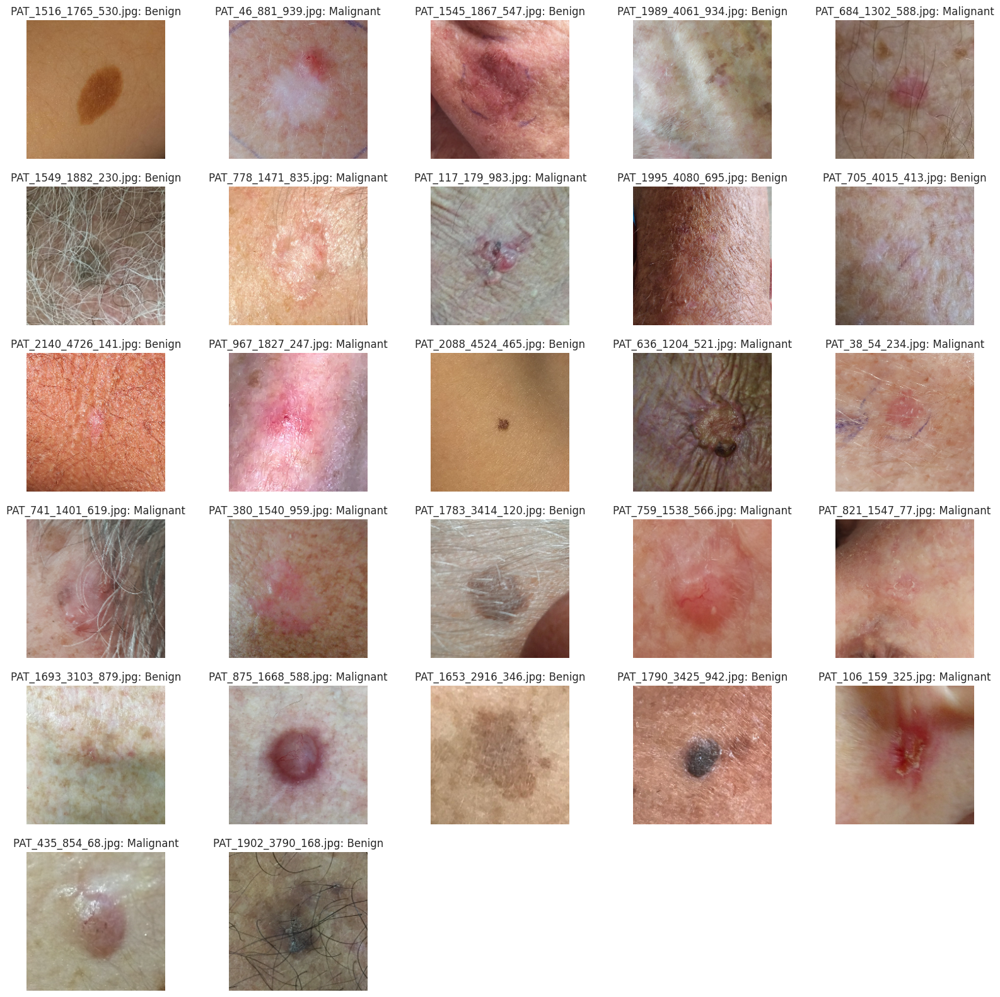

In [18]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_PAD_UFES_train = prepare_dataset(df_train_PAD_UFES, images_path, file_name_column = "name", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


## Concatenar datasets train tf

In [19]:
import tensorflow as tf

# Concatenar los datasets
combined_dataset_train = dataset_fitz_train.concatenate(dataset_ISIC_train).concatenate(dataset_PAD_UFES_train)

# Optimizar la carga del dataset para acelerar la concatenación
combined_dataset_train = combined_dataset_train.cache().prefetch(tf.data.AUTOTUNE)

# Ver el número total de ejemplos
num_examples = tf.data.experimental.cardinality(combined_dataset_train).numpy()
print(f"Número total de ejemplos en el dataset combinado: {num_examples}")


Número total de ejemplos en el dataset combinado: 5865


## Modelo 5 Valquiria

In [20]:
# CARGAR USANDO TF 2.15 (KERAS 2). COLAB USA KERAS 3 Y NO LEE ESTO ASÍ COMO ESTÁ.
path_iuhi = "/content/drive/MyDrive/Tesis/Valquiria/Valquiria II /WandB/Modelos/model" # Se actualizo a Keras 3 y ya no lee modelos en saved_model. Solo usando TFLayers o algo así pero no es lo mismo creo. USAR KERAS 2 (tf 2.15)
path_yo = "/content/drive/MyDrive/local ood valquiria/modelo5_valquiria.h5"
model = tf.keras.models.load_model(path_iuhi)

Info del modelo:

In [21]:
import tensorflow as tf

# Obtener la información de las entradas del modelo
input_shape = model.input_shape
input_dtype = model.input.dtype

print(f"Input Shape: {input_shape}")
print(f"Input Data Type: {input_dtype}")

# Obtener detalles sobre el preprocesamiento (si existe alguna capa de preprocesamiento)
for layer in model.layers:
    if isinstance(layer, tf.keras.layers.Rescaling):
        print(f"Rescaling layer found: scale {layer.scale}, offset {layer.offset}")
    elif isinstance(layer, tf.keras.layers.Normalization):
        print(f"Normalization layer found: mean {layer.mean.numpy()}, variance {layer.variance.numpy()}")

# Si el modelo tiene una capa de entrada específica
if isinstance(model.input, tf.Tensor):
    input_tensor = model.input
    print(f"Input Tensor: {input_tensor}")

# Si el modelo usa una función de preprocesamiento
try:
    preprocess_input = model.preprocess_input
    print("Preprocessing function found.")
except AttributeError:
    preprocess_input = None
    print("No preprocessing function found.")

Input Shape: (None, 3, 224, 224)
Input Data Type: <dtype: 'float32'>
No preprocessing function found.


## Test: HIBA Consumer AI

In [22]:
images_path = ID_SETS_PATH_IUHI + CONSUMER_AI_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + CONSUMER_AI_CSV_TEST_PATH

df_test = pd.read_csv(csv_path)
df_test.head()
print(f"tamaño del dataset: {len(df_test)}")

tamaño del dataset: 35


###Reviso imágenes

In [23]:
from PIL import Image
import numpy as np
import pandas as pd

df_image_info = extract_image_info(df = df_test, file_name_column = "name", images_path = images_path, file_extension = ".jpg")
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1738, 1738, 3)",0,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(904, 904, 3)",31,234,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1314, 1313, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(782, 783, 3)",10,254,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(515, 515, 3)",71,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1049, 1049, 3)",3,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(1171, 1171, 3)",4,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(704, 785, 3)",86,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(603, 619, 3)",78,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Consumer ...,"(949, 954, 3)",30,255,uint8


### Convierto a tf (+ display opcional)

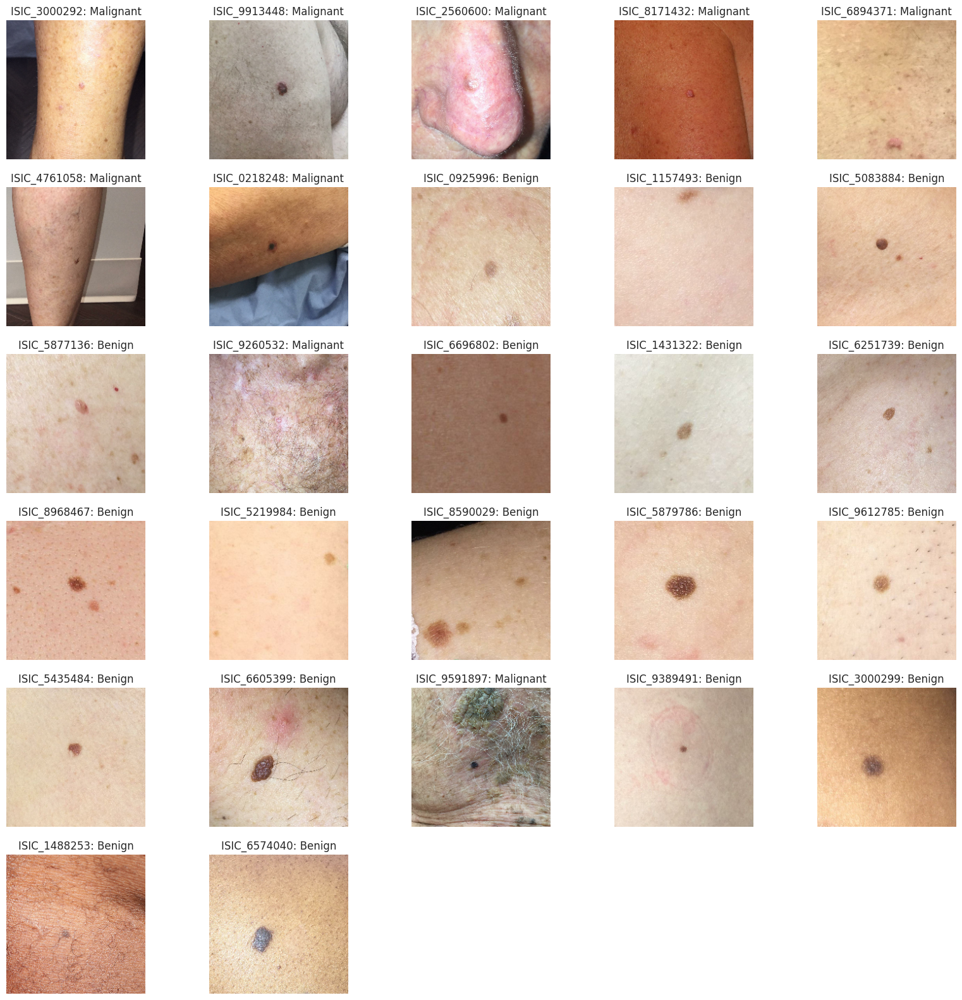

In [24]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_consumer_ai_test = prepare_dataset(df_test, images_path, file_name_column = "name", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension=".jpg")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [25]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
dataset_consumer_ai_batcheado = dataset_consumer_ai_test.batch(len(dataset_consumer_ai_test))
predictions = model.predict(dataset_consumer_ai_batcheado)

predictions

1/1 [==============================] - 9s 9s/step


array([[0.01906671],
       [0.42573664],
       [0.7796103 ],
       [0.17946017],
       [0.10307044],
       [0.03514671],
       [0.15715925],
       [0.00913631],
       [0.00440963],
       [0.01439083],
       [0.04136007],
       [0.44174245],
       [0.00300181],
       [0.02979794],
       [0.05696899],
       [0.13585952],
       [0.00626609],
       [0.01005901],
       [0.00316581],
       [0.05296258],
       [0.01787969],
       [0.36192933],
       [0.26196307],
       [0.10304888],
       [0.05956777],
       [0.00364793],
       [0.17824638],
       [0.18271284],
       [0.11265144],
       [0.01114997],
       [0.06571056],
       [0.19343133],
       [0.1819944 ],
       [0.6739576 ],
       [0.11347461]], dtype=float32)

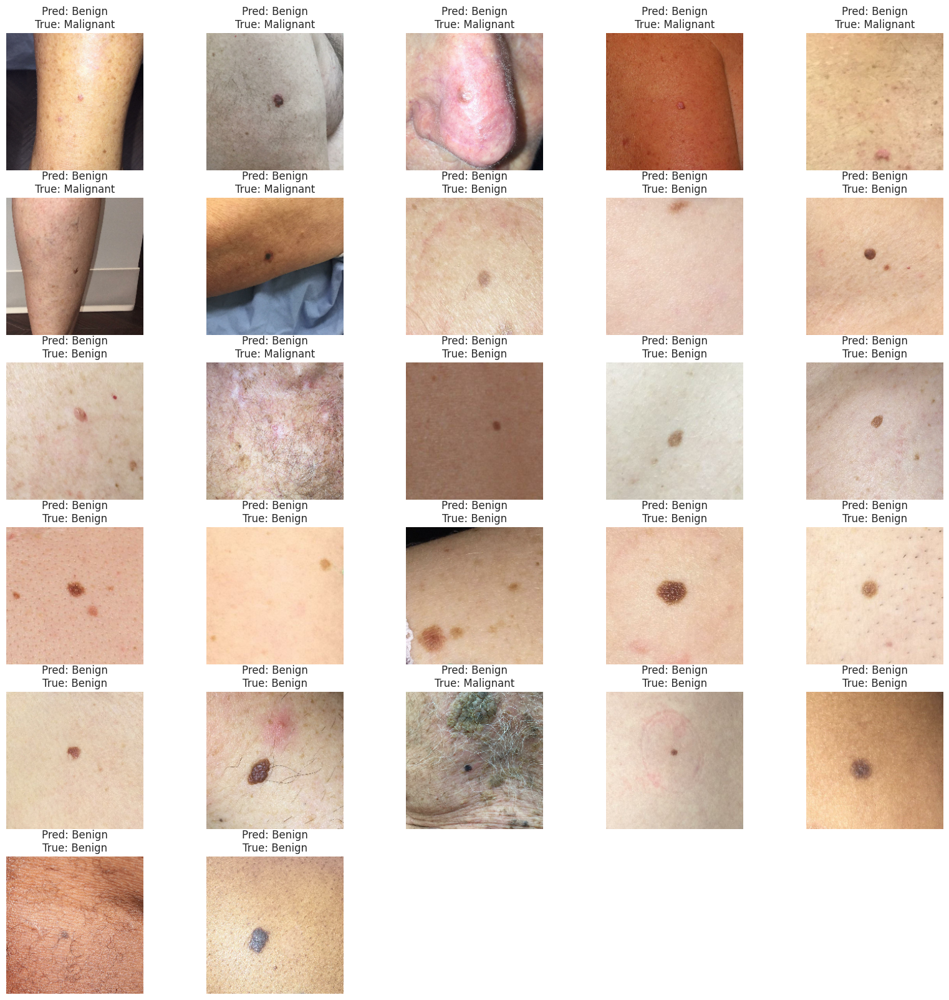

In [26]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_consumer_ai_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.7142857142857143
Confusion Matrix:
[[14  6]
 [ 4 11]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.78      0.70      0.74        20
   Malignant       0.65      0.73      0.69        15

    accuracy                           0.71        35
   macro avg       0.71      0.72      0.71        35
weighted avg       0.72      0.71      0.72        35



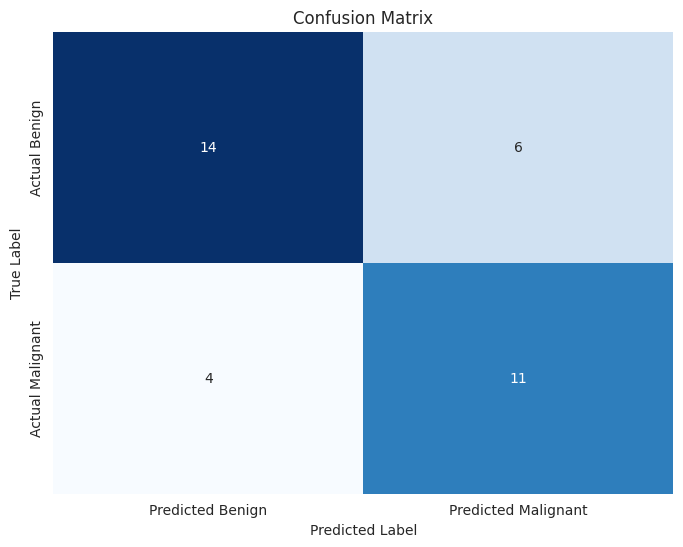

AUC (ROC): 0.8066666666666666
Precision-Recall AUC: 0.7749231592584107


In [27]:
evaluate_model_performance(dataset_consumer_ai_batcheado, predictions, threshold=0.1)


## Test: DDI


In [28]:
images_path = ID_SETS_PATH_IUHI + DDI_IMAGES_PATH
images_path_original = "/content/drive/MyDrive/Tesis/ID sets/DDI/images original RGBA png" #(carpeta images_original_RGBA_png)

csv_path_original = "/content/drive/MyDrive/Tesis/ID sets/DDI/Stanford - prediccionesstanford_28Feb_original_png.csv"
csv_path = ID_SETS_PATH_IUHI + DDI_CSV_TEST_PATH

df_test_ddi_png = pd.read_csv(csv_path_original)
print(f"tamaño del dataset: {len(df_test_ddi_png)}")
df_test_ddi_png.head()

tamaño del dataset: 656


,Unnamed: 0,DDI_ID,DDI_file,skin_tone,malignant,disease,result_1,result_2,filtro 1,filtro 2,resultado,modelo 0,modelo 1,modelo 2,modelo 3,modelo 4,modelo 5,modelo 6,modelo 7,modelo 8
0,0,1,000001.png,56,True,melanoma-in-situ,0.9998618364,0.002357,1,0,0,0.037044,0.092266,0.066389,0.095087,0.054655,0.093870,0.091003,0.318142,0.092266
1,1,2,000002.png,56,True,melanoma-in-situ,0.0001134801787,0.017741,0,0,1,0.156222,0.003952,0.036011,0.165662,0.251726,0.125065,0.084946,0.246434,0.003952
2,2,3,000003.png,56,True,mycosis-fungoides,6.36e-12,0.603778,0,1,0,0.048407,0.004547,0.048580,0.024234,0.071158,0.044688,0.025085,0.043403,0.004547
3,3,4,000004.png,56,True,squamous-cell-carcinoma-in-situ,9E-12,0.087259,0,0,1,0.233128,0.695503,0.075068,0.290248,0.288277,0.771214,0.245111,0.435429,0.695503
4,4,5,000005.png,12,True,basal-cell-carcinoma,1.87e-12,0.014297,0,0,1,0.458695,0.286403,0.447675,0.725066,0.359632,0.694287,0.834334,0.815580,0.286403


### Cambio nombres .png a .jpg y creo nuevo csv

Cambio nombres ".png" a ".jpg"

In [29]:
# Cambiar las extensiones de .png a .jpg en la columna DDI_file
df_test_ddi = df_test_ddi_png.copy()

df_test_ddi['DDI_file'] = df_test_ddi['DDI_file'].str.replace('.png', '.jpg', regex=False)

# Verificar el cambio
print(f"Tamaño del dataset: {len(df_test_ddi)}")
df_test_ddi.head()

Tamaño del dataset: 656


,Unnamed: 0,DDI_ID,DDI_file,skin_tone,malignant,disease,result_1,result_2,filtro 1,filtro 2,resultado,modelo 0,modelo 1,modelo 2,modelo 3,modelo 4,modelo 5,modelo 6,modelo 7,modelo 8
0,0,1,000001.jpg,56,True,melanoma-in-situ,0.9998618364,0.002357,1,0,0,0.037044,0.092266,0.066389,0.095087,0.054655,0.093870,0.091003,0.318142,0.092266
1,1,2,000002.jpg,56,True,melanoma-in-situ,0.0001134801787,0.017741,0,0,1,0.156222,0.003952,0.036011,0.165662,0.251726,0.125065,0.084946,0.246434,0.003952
2,2,3,000003.jpg,56,True,mycosis-fungoides,6.36e-12,0.603778,0,1,0,0.048407,0.004547,0.048580,0.024234,0.071158,0.044688,0.025085,0.043403,0.004547
3,3,4,000004.jpg,56,True,squamous-cell-carcinoma-in-situ,9E-12,0.087259,0,0,1,0.233128,0.695503,0.075068,0.290248,0.288277,0.771214,0.245111,0.435429,0.695503
4,4,5,000005.jpg,12,True,basal-cell-carcinoma,1.87e-12,0.014297,0,0,1,0.458695,0.286403,0.447675,0.725066,0.359632,0.694287,0.834334,0.815580,0.286403


Guardo el nuevo csv

*correr una sola vez*



```
# Guardar el DataFrame actualizado en un nuevo archivo CSV
output_csv_path = "/content/drive/MyDrive/Tesis/ID sets/DDI/Stanford - prediccionesstanford_28Feb.csv" # sería el csv_path pero lo dejo así que es mas claro
df_test_ddi.to_csv(output_csv_path, index=False)
print(f"Archivo actualizado guardado en: {output_csv_path}")
```



###Reviso imágenes originales

In [30]:
df_image_info = extract_image_info(df = df_test_ddi_png, file_name_column = "DDI_file", images_path = images_path_original, file_extension = "", num_images = 15) # son .png
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(549, 948, 3)",0,219,uint8
1,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(618, 798, 4)",0,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(678, 921, 3)",64,253,uint8
3,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(285, 306, 4)",6,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 230, 4)",19,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(458, 323, 4)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(675, 918, 3)",5,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(666, 494, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 438, 4)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(654, 482, 3)",22,255,uint8


### RGBA a RGB y .png a .jpg (creo nueva carpeta)

*correr una sola vez*



```
output_path_images = "/content/drive/MyDrive/Tesis/ID sets/DDI/images" # sería images_path pero lo pongo así para que quede más claro
convert_to_rgb_and_jpg(df_test_ddi, file_name_column = "DDI_file", images_path = images_path_original, output_path = output_path_images)
```



Verifico que estén en RGB y .jpg

Las imgs están en .jpg

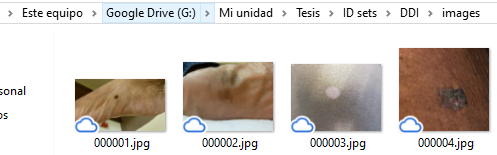

Verifico que estén en RGB (channels = 3)

In [31]:
df_image_info = extract_image_info(df = df_test_ddi, file_name_column = "DDI_file", images_path = images_path, file_extension = "", num_images = 15) # son .png
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(549, 948, 3)",0,220,uint8
1,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(618, 798, 3)",0,247,uint8
2,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(678, 921, 3)",63,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(285, 306, 3)",4,200,uint8
4,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 230, 3)",17,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(458, 323, 3)",0,253,uint8
6,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(675, 918, 3)",5,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(666, 494, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(387, 438, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/DDI/image...,"(654, 482, 3)",18,255,uint8


### Convierto a tf (+ display opcional)

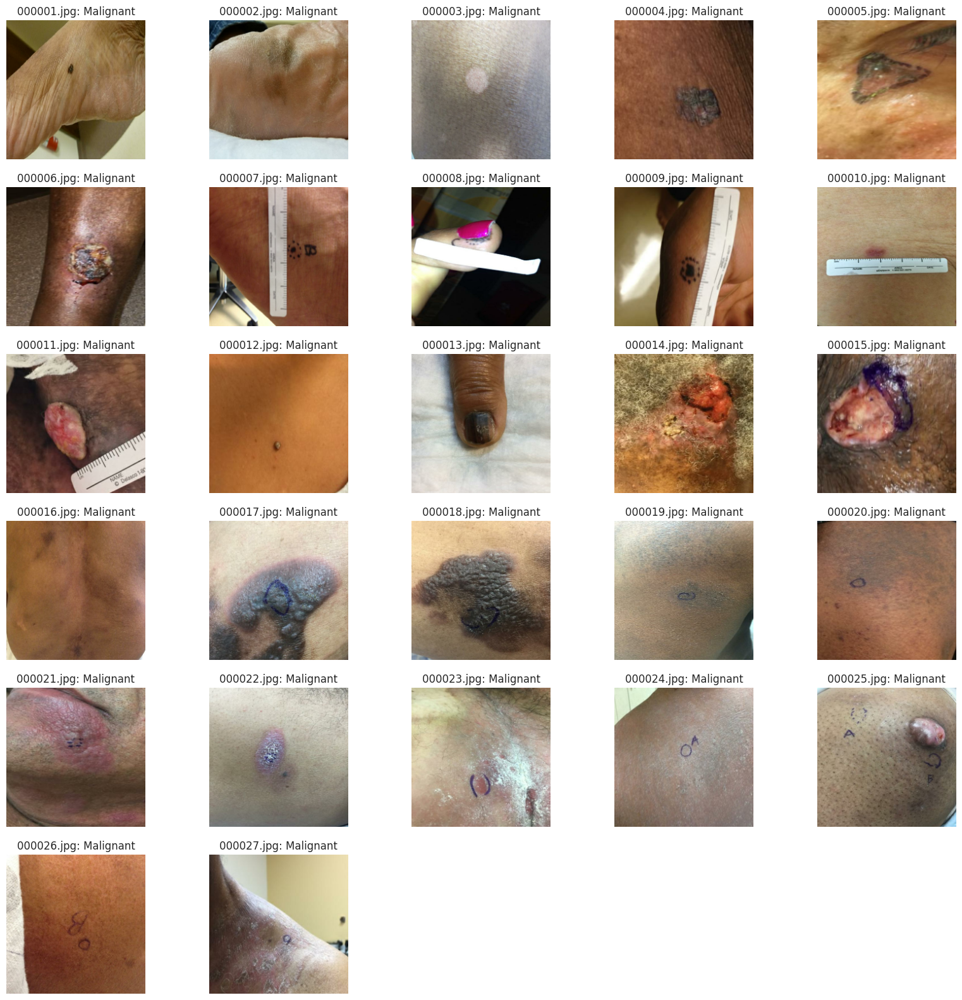

In [32]:
# Configuración de los parámetros
#label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_ddi_test = prepare_dataset(df_test_ddi, images_path, file_name_column = "DDI_file", label_column='malignant', label_map=None, #None porque ya está que True es 1 y False 0 para malignant
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [33]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
dataset_ddi_test_batcheado = dataset_ddi_test.batch(len(dataset_ddi_test))
predictions = model.predict(dataset_ddi_test_batcheado)

predictions

1/1 [==============================] - 576s 576s/step


array([[0.06993989],
       [0.13653068],
       [0.04091128],
       [0.85834825],
       [0.7033206 ],
       [0.9139782 ],
       [0.259516  ],
       [0.46500412],
       [0.2298341 ],
       [0.28322494],
       [0.42437792],
       [0.05051132],
       [0.09133128],
       [0.14806418],
       [0.7179563 ],
       [0.09599033],
       [0.15858693],
       [0.4188846 ],
       [0.19875267],
       [0.20406374],
       [0.6982939 ],
       [0.471482  ],
       [0.2661625 ],
       [0.05404039],
       [0.13407603],
       [0.03705262],
       [0.8161255 ],
       [0.08891816],
       [0.03790179],
       [0.3289719 ],
       [0.02931442],
       [0.118666  ],
       [0.11232781],
       [0.33187738],
       [0.05319858],
       [0.09290218],
       [0.46128124],
       [0.74240816],
       [0.3143189 ],
       [0.47084498],
       [0.44367987],
       [0.3089565 ],
       [0.47071636],
       [0.41283798],
       [0.7252302 ],
       [0.50421804],
       [0.08301128],
       [0.178

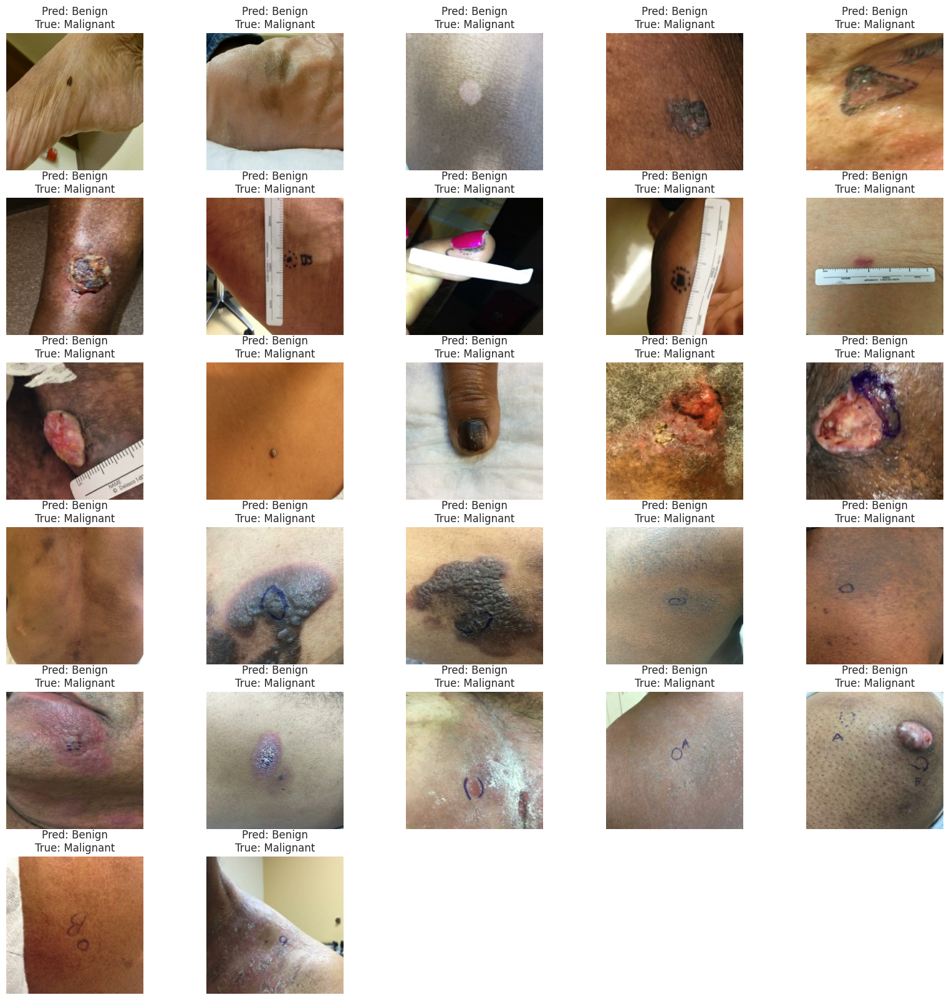

In [34]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_ddi_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.4298780487804878
Confusion Matrix:
[[142 343]
 [ 31 140]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.82      0.29      0.43       485
   Malignant       0.29      0.82      0.43       171

    accuracy                           0.43       656
   macro avg       0.56      0.56      0.43       656
weighted avg       0.68      0.43      0.43       656



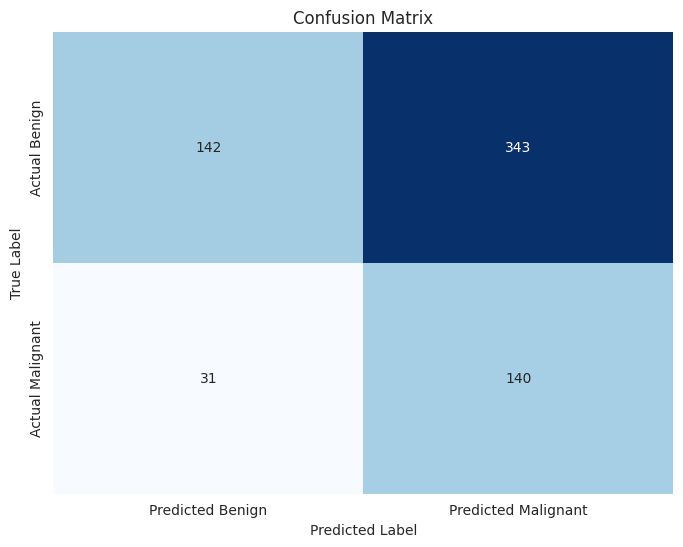

AUC (ROC): 0.6586724543317055
Precision-Recall AUC: 0.42781060028982754


In [35]:
evaluate_model_performance(dataset_ddi_test_batcheado, predictions, threshold=0.1)


## Test: Institucional

In [36]:
images_path = ID_SETS_PATH_IUHI + INSTITUCIONAL_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + INSTITUCIONAL_CSV_TEST_PATH

df_test = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_test)}")
df_test.head()

tamaño del dataset: 127


,Unnamed: 0,filename,image_type,benign_malignant,diagnosis,diagnosis_confirm_type,anatom_site_general,age,sex,lesion_id,...,result_2,binary_result_1,binary_result_2,aprobada,subset,subset_test,modelo 0,modelo 2,modelo 3,modelo 5
0,6,image203.jpg,clinical,benign,vascular lesion,NaN,anterior torso,76.0,male,les5,...,0.001080,0,0,VERDADERO,Test,Test_A,0.024185,0.039990,0.432276,0.102198
1,11,image837.jpg,clinical,benign,actinic keratosis,histopathology,posterior torso,74.0,female,les1,...,0.002301,0,0,VERDADERO,Test,Test_A,0.070791,0.032154,0.057352,0.087453
2,12,image838.jpg,clinical,malignant,basal cell carcinoma,histopathology,anterior torso,74.0,female,les2,...,0.007297,0,0,VERDADERO,Test,Test_A,0.082425,0.240629,0.233446,0.033466
3,14,image888.jpg,clinical,malignant,melanoma,histopathology,posterior torso,64.0,male,les1,...,0.050514,0,0,VERDADERO,Test,Test_A,0.079354,0.296706,0.927234,0.796668
4,15,image890.jpg,clinical,malignant,squamous cell carcinoma,histopathology,upper extremity,67.0,male,les1,...,0.008407,0,0,VERDADERO,Test,Test_A,0.077548,0.035709,0.028295,0.066248


###Reviso imágenes

In [37]:
df_image_info = extract_image_info(df = df_test, file_name_column = "filename", images_path = images_path, file_extension = "", num_images = 15)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1024, 768, 3)",16,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1682, 1056, 3)",9,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(733, 1041, 3)",33,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(384, 512, 3)",11,235,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(170, 170, 3)",60,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1035, 776, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(884, 663, 3)",2,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(910, 992, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(1220, 1627, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Instituci...,"(573, 559, 3)",0,255,uint8


### Convierto a tf (+ display opcional)

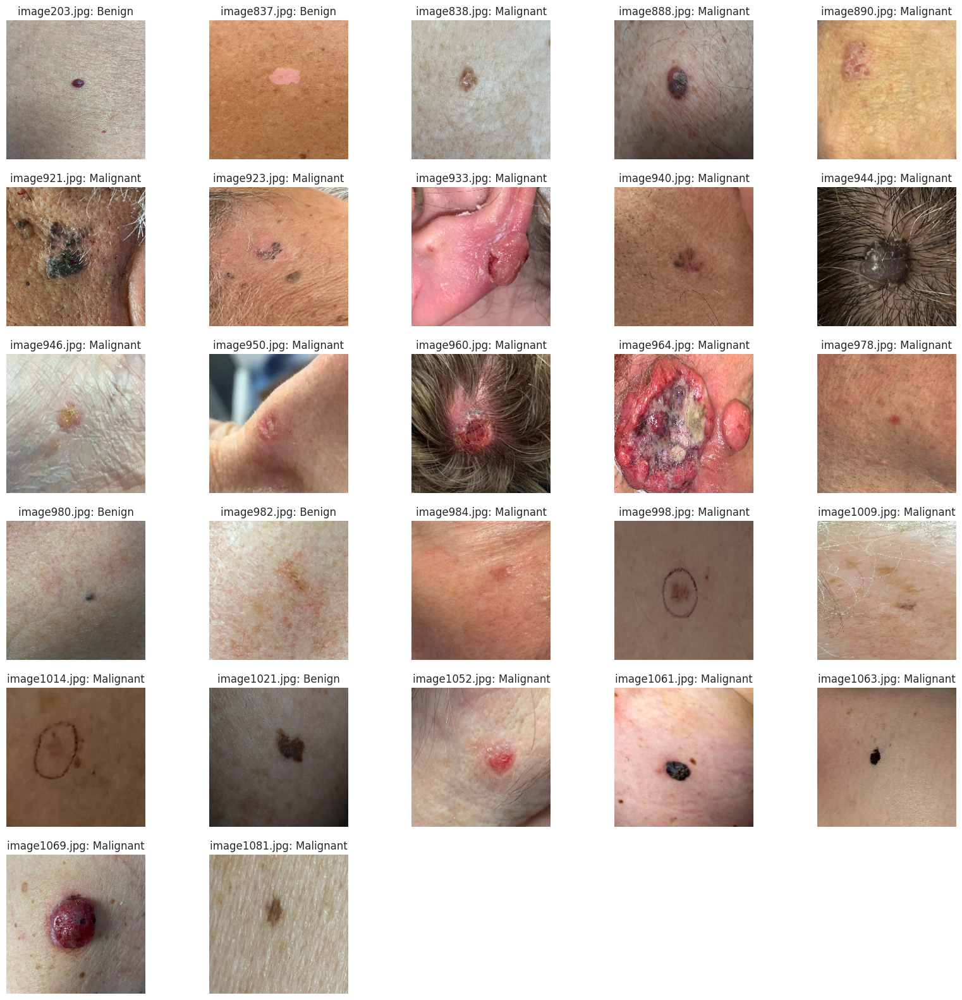

In [38]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_institucional_test = prepare_dataset(df_test, images_path, file_name_column = "filename", label_column='benign_malignant', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [39]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
dataset_institucional_test_batcheado = dataset_institucional_test.batch(len(dataset_institucional_test))
predictions = model.predict(dataset_institucional_test_batcheado)

predictions

1/1 [==============================] - 108s 108s/step


array([[0.0791938 ],
       [0.06812301],
       [0.02797788],
       [0.82163656],
       [0.07634611],
       [0.5737455 ],
       [0.6799577 ],
       [0.8412745 ],
       [0.7299264 ],
       [0.41449174],
       [0.3821775 ],
       [0.33029032],
       [0.8550982 ],
       [0.7118074 ],
       [0.16670826],
       [0.12711076],
       [0.14442953],
       [0.02589628],
       [0.04668226],
       [0.18963005],
       [0.03363723],
       [0.42809638],
       [0.78565925],
       [0.78516155],
       [0.7388831 ],
       [0.48438308],
       [0.10348887],
       [0.16235381],
       [0.14317337],
       [0.35153908],
       [0.3119801 ],
       [0.37611365],
       [0.19445552],
       [0.11202864],
       [0.43733525],
       [0.09416991],
       [0.7882929 ],
       [0.7145021 ],
       [0.93865293],
       [0.13563713],
       [0.54321647],
       [0.8079582 ],
       [0.91878974],
       [0.5462114 ],
       [0.5774426 ],
       [0.26821303],
       [0.38777918],
       [0.710

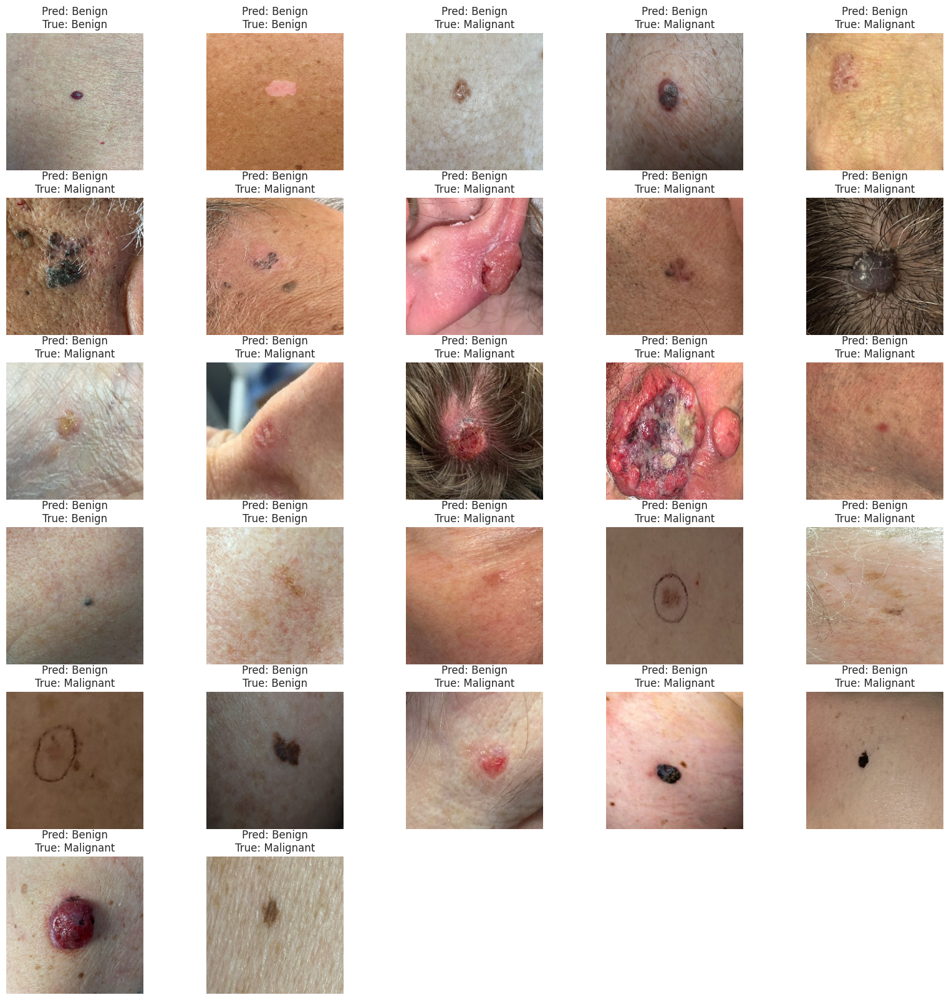

In [40]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_institucional_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.7086614173228346
Confusion Matrix:
[[18 26]
 [11 72]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.62      0.41      0.49        44
   Malignant       0.73      0.87      0.80        83

    accuracy                           0.71       127
   macro avg       0.68      0.64      0.64       127
weighted avg       0.70      0.71      0.69       127



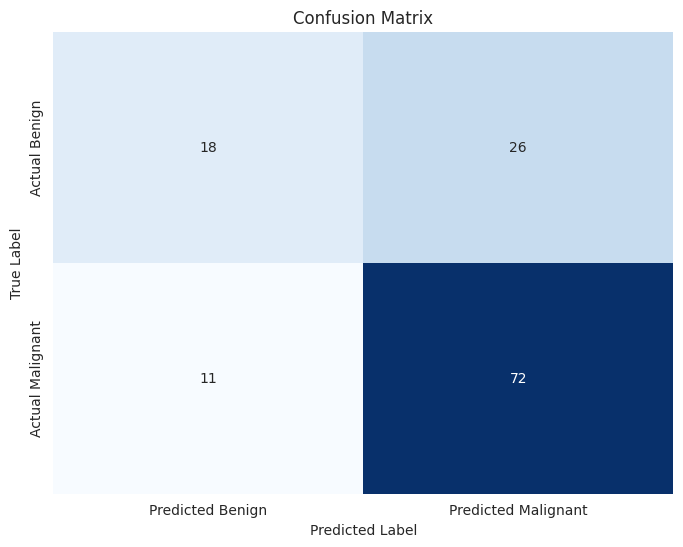

AUC (ROC): 0.735761226725082
Precision-Recall AUC: 0.8517345821283592


In [41]:
evaluate_model_performance(dataset_institucional_test_batcheado, predictions, threshold=0.1)


## Test: Fitz

In [42]:
images_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_IMAGES_PATH
csv_path = ID_SETS_PATH_IUHI + FITZPATRICK17K_CSV_TEST_PATH

df_test = pd.read_csv(csv_path)

print(f"tamaño del dataset: {len(df_test)}")
df_test.head()

tamaño del dataset: 395


,Unnamed: 0,img_path,label
0,1647,aac12918e020bed883f2eb321dac661e.jpg,malignant
1,847,4049f356db33c72f029d619fe35f6fc5.jpg,benign
2,2379,257b98dac6241fa7fc474d3ccd0cc23e.jpg,malignant
3,402,145e13a479f0c026fcb0630d2f9d47b8.jpg,benign
4,2041,07bbb2e37d5e4febf70890df43c9fbd6.jpg,malignant


###Reviso imágenes

In [43]:
df_image_info = extract_image_info(df = df_test, file_name_column = "img_path", images_path = images_path, file_extension = "", num_images = 15)
df_image_info

,image_path,dimensions,min_value,max_value,data_type
0,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(192, 286, 3)",0,255,uint8
1,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(353, 435, 3)",4,255,uint8
2,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(368, 507, 3)",0,255,uint8
3,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(348, 480, 3)",33,255,uint8
4,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(320, 320, 3)",0,255,uint8
5,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(400, 443, 3)",0,255,uint8
6,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(400, 400, 3)",0,255,uint8
7,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(393, 450, 3)",0,255,uint8
8,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(449, 347, 3)",0,255,uint8
9,/content/drive/MyDrive/Tesis/ID sets/Fitzpatri...,"(316, 444, 3)",0,255,uint8


### Convierto a tf (+ display opcional)

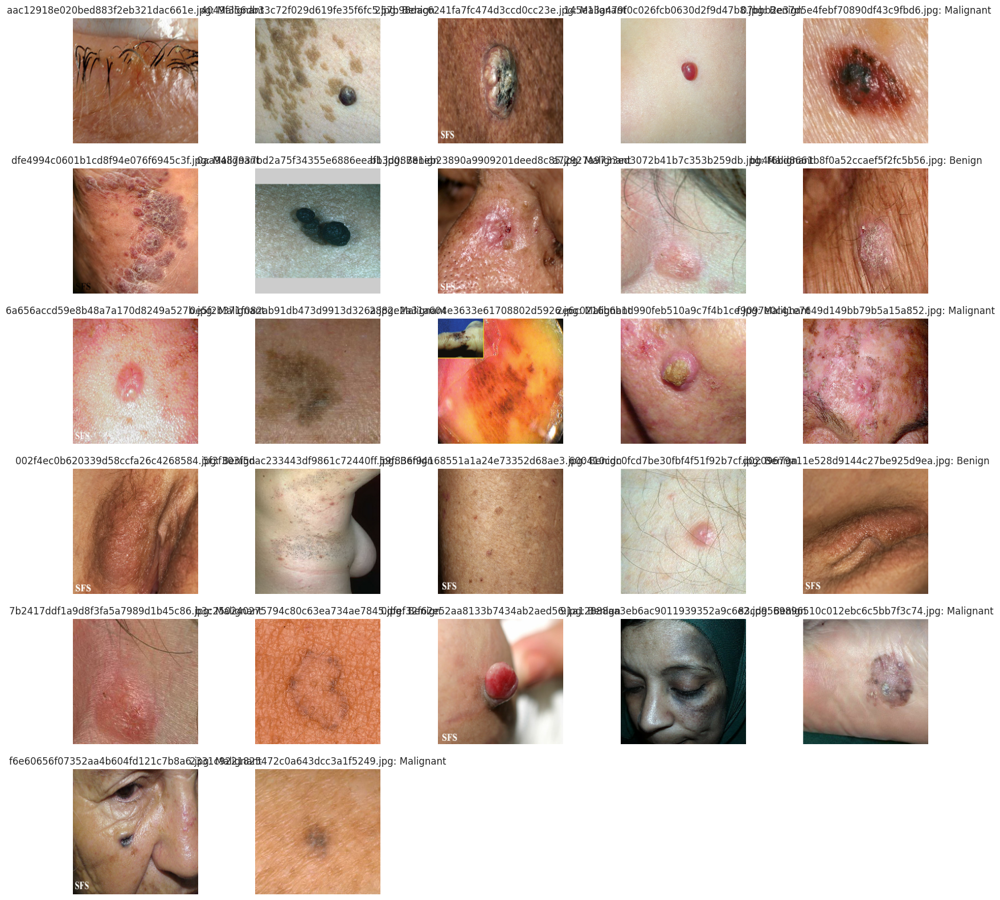

In [44]:
# Configuración de los parámetros
label_map = {'benign': 0, 'malignant': 1}

# Llamada a la función
dataset_fitz_test = prepare_dataset(df_test, images_path, file_name_column = "img_path", label_column='label', label_map=label_map,
                          resize_shape=(224, 224), normalize=True, transpose=True,
                          display_samples=True, num_display_samples=27, remove_labels=False, file_extension="")


### Inferencia / Predictions (Requiere estar conectado a GPU T4, si no tira error)

Para usar model.predict sí o sí tengo que pasarle un batch. Puedo elegir un batch size o usar el len total de mi dataset

In [45]:
# Realizar la inferencia
#dataset_consumer_ai_batcheado = dataset_consumer_ai.batch(32)
dataset_fitz_test_batcheado = dataset_fitz_test.batch(len(dataset_fitz_test))
predictions = model.predict(dataset_fitz_test_batcheado)

predictions

1/1 [==============================] - 337s 337s/step


array([[0.22233823],
       [0.00695178],
       [0.8672983 ],
       [0.07097397],
       [0.90764713],
       [0.40978143],
       [0.5896871 ],
       [0.727501  ],
       [0.6156773 ],
       [0.37335092],
       [0.8627273 ],
       [0.05309558],
       [0.34958735],
       [0.6993956 ],
       [0.9403034 ],
       [0.58137006],
       [0.28880405],
       [0.02943729],
       [0.27843097],
       [0.32149774],
       [0.17301969],
       [0.11880554],
       [0.44504684],
       [0.09336282],
       [0.5679223 ],
       [0.78249365],
       [0.4580408 ],
       [0.45787585],
       [0.6024864 ],
       [0.9511402 ],
       [0.8029074 ],
       [0.4044357 ],
       [0.51472926],
       [0.96130985],
       [0.7451798 ],
       [0.24101616],
       [0.09852251],
       [0.15494046],
       [0.8514397 ],
       [0.42542514],
       [0.18404731],
       [0.02659212],
       [0.68824273],
       [0.17041114],
       [0.7135789 ],
       [0.754214  ],
       [0.18991183],
       [0.135

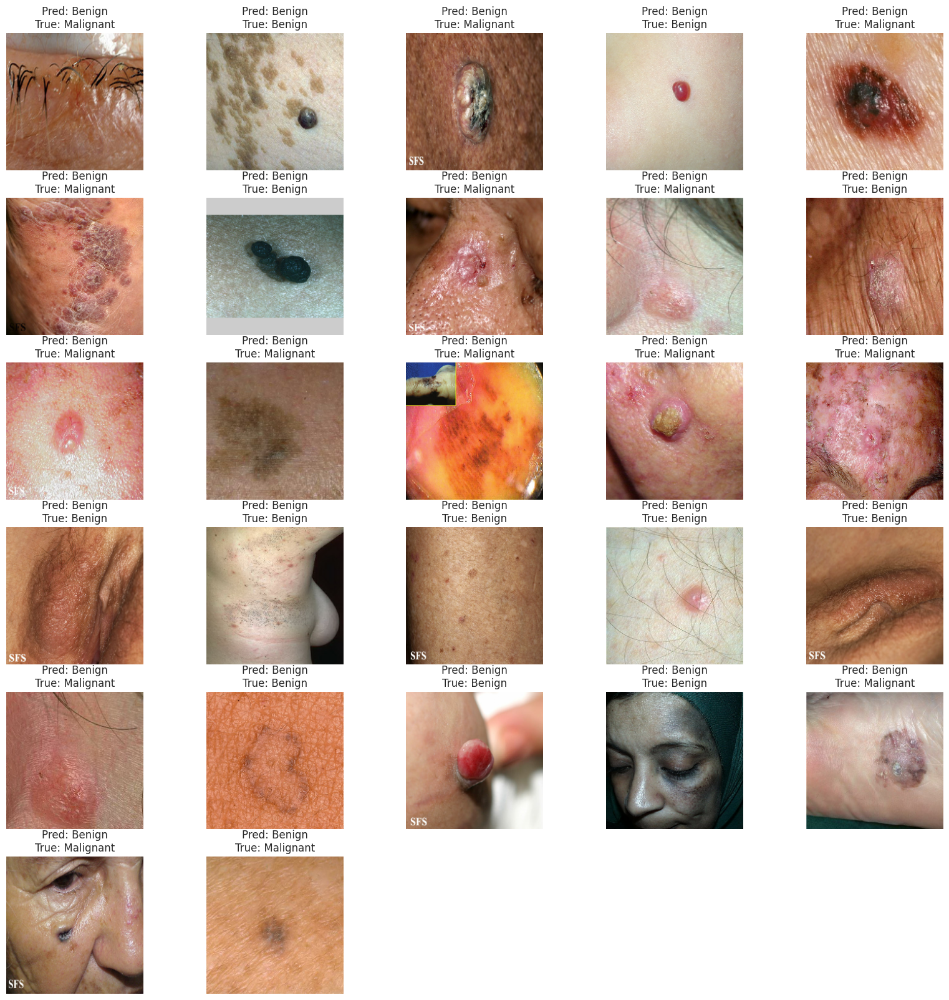

In [46]:
# Mostrar las primeras 27 imágenes y sus predicciones
display_predictions(dataset_fitz_test_batcheado, predictions, 27, threshold = 0.5)

### Métricas, Matriz de confusión, AUC y Curvas ROC y Pr-Rec.

Accuracy: 0.6962025316455697
Confusion Matrix:
[[ 36 113]
 [  7 239]]
Classification Report:
              precision    recall  f1-score   support

      Benign       0.84      0.24      0.38       149
   Malignant       0.68      0.97      0.80       246

    accuracy                           0.70       395
   macro avg       0.76      0.61      0.59       395
weighted avg       0.74      0.70      0.64       395



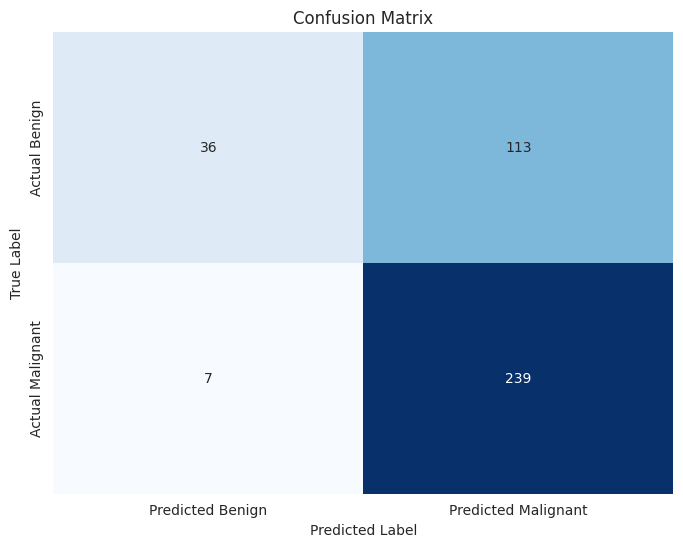

AUC (ROC): 0.8133355159054947
Precision-Recall AUC: 0.8710009040509246


In [47]:
evaluate_model_performance(dataset_fitz_test_batcheado, predictions, threshold=0.1)


## Concatenar datasets test tf

In [48]:
# Concatenar los datasets
combined_dataset_test = dataset_consumer_ai_test.concatenate(dataset_ddi_test).concatenate(dataset_institucional_test).concatenate(dataset_fitz_test)

# Optimizar la carga del dataset para acelerar la concatenación
combined_dataset_test = combined_dataset_test.cache().prefetch(tf.data.AUTOTUNE)

# Ver el número total de ejemplos
num_examples = tf.data.experimental.cardinality(combined_dataset_test).numpy()
print(f"Número total de ejemplos en el dataset combinado: {num_examples}")

Número total de ejemplos en el dataset combinado: 1213


# OODEEL

In [51]:
modelo5_valquiria = model

In [50]:
from oodeel.datasets.tf_data_handler import TFDataHandler
from oodeel.datasets import OODDataset

# Convertir el dataset a un formato compatible con OODDataset
def convert_to_dict(image, label):
    return {"input_0": image, "label": label}

class TFDataHandlerCustom(TFDataHandler):
    @classmethod
    def load_custom_dataset(cls, dataset_id, keys):
        if keys is None:
            keys = ['input_0', 'label']
        def to_dict(image, label):
            return {keys[0]: image, keys[1]: label}
        dataset = dataset_id.map(to_dict)
        return dataset

In [52]:
combined_dataset_train_dict = combined_dataset_train.map(lambda image, label: convert_to_dict(image, label))
combined_dataset_test_dict= combined_dataset_test.map(lambda image, label: convert_to_dict(image, label))

batch_size = 27
ds_fit = OODDataset(
    combined_dataset_train_dict,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size)

In [53]:
from oodeel.datasets import OODDataset

batch_size = 27
ds_in = OODDataset(
    combined_dataset_test_dict,
    backend="tensorflow",
    keys=["input_0", "label"]
).prepare(batch_size)

# Crear el dataset ds_out a partir de fashion_mnist y limitarlo a 27 elementos
full_ds_out = OODDataset(
    'fashion_mnist', load_kwargs={"split":"test"},
    backend="tensorflow").prepare(batch_size)

# Tomar solo 27 elementos de ds_out
ds_out = full_ds_out.take(27) # ojo que parece que toma como 700 y pico, no 27

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/2 [00:00<?, ? splits/s]

Generating train examples...:   0%|          | 0/60000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/fashion_mnist/3.0.1.incomplete72I40W/fashion_mnist-train.tfrecord*...:   0…

Generating test examples...:   0%|          | 0/10000 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/fashion_mnist/3.0.1.incomplete72I40W/fashion_mnist-test.tfrecord*...:   0%…

Dataset fashion_mnist downloaded and prepared to /root/tensorflow_datasets/fashion_mnist/3.0.1. Subsequent calls will reuse this data.


In [54]:
from oodeel.methods import MLS
from oodeel.methods import Mahalanobis

mls = MLS()
mls.fit(modelo5_valquiria)
mahalanobis = Mahalanobis(eps=0.002)
mahalanobis.fit(model, feature_layers_id=[-2], fit_dataset =ds_fit)

def preprocess_image(image):
    # Convertir la imagen en escala de grises a RGB
    image = tf.image.grayscale_to_rgb(image)
    # Redimensionar la imagen a 224x224
    image = tf.image.resize(image, (224, 224))
    # Normalizar los valores de los píxeles a un rango de [0, 1]
    image = image / 255.0
    # Cambiar el orden de las dimensiones de la imagen a NHWC
    image = tf.transpose(image, [0, 3, 1, 2])
    return image

# Preprocesar las imágenes del dataset de entrada
ds_processed_in = ds_in #.map(lambda x, y: (preprocess_image(x), y))
ds_processed_out = ds_out.map(lambda x, y: (preprocess_image(x), y))

#scores_in, info_in = mls.score(ds_processed_in)
#scores_out, info_out = mls.score(ds_processed_out)

scores_in, info_in = mahalanobis.score(ds_processed_in)
scores_out, info_out = mahalanobis.score(ds_processed_out)

In [67]:
scores_in, info_in

(array([225.98266602, 162.31161499, 133.45018005, ..., 162.28547668,
        214.        , 195.02229309]),
 {'labels': array([1, 1, 1, ..., 1, 0, 0], dtype=int32),
  'logits': array([[-2.2458375 ],
         [-1.7615469 ],
         [ 0.08534631],
         ...,
         [ 1.239235  ],
         [-1.3348567 ],
         [ 0.76671034]], dtype=float32)})

In [57]:
scores_out, info_out

(array([261.21313477, 360.5581665 , 331.79711914, 334.90478516,
        199.62049866, 469.52160645, 269.60766602, 421.82489014,
        331.76922607, 472.52728271, 298.4095459 , 322.6439209 ,
        292.074646  , 298.6282959 , 196.01831055, 308.42675781,
        321.05197144, 276.64590454, 240.12409973, 380.75018311,
        540.51776123, 449.98196411, 600.07476807, 306.88912964,
        251.83770752, 238.39190674, 172.89572144, 383.41192627,
        362.33569336, 371.27172852, 226.72444153, 200.83828735,
        587.91540527, 300.61138916, 293.64697266, 296.95904541,
        251.55827332, 326.11685181, 252.64305115, 356.57043457,
        318.98724365, 463.11523438, 334.8057251 , 495.23956299,
        366.11407471, 396.07077026, 383.07147217, 266.03585815,
        201.77313232, 473.81536865, 441.31097412, 331.0871582 ,
        505.27996826, 254.18096924, 364.1605835 , 335.86669922,
        249.71923828, 227.44476318, 768.94128418, 203.08390808,
        262.71682739, 532.52893066, 359.

In [58]:
from oodeel.eval.metrics import bench_metrics

metrics = bench_metrics(
    (scores_in, scores_out),
    metrics = ["auroc", "fpr95tpr"],
    )
metrics

{'auroc': 0.8784922597783272, 'fpr95tpr': 0.38994229183841717}

/usr/local/lib/python3.10/dist-packages/sklearn/manifold/_t_sne.py:1162: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



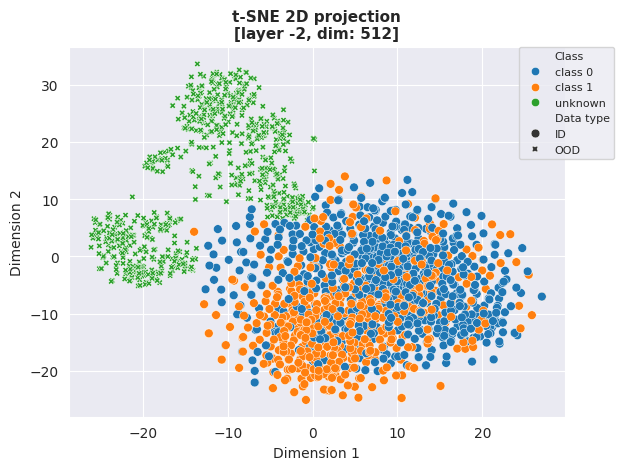

In [59]:
from oodeel.eval.plots import plot_ood_scores, plot_roc_curve, plot_2D_features
plot_2D_features(
    model=modelo5_valquiria,
    in_dataset=ds_processed_in,
    out_dataset=ds_processed_out,
    output_layer_id=-2,
)

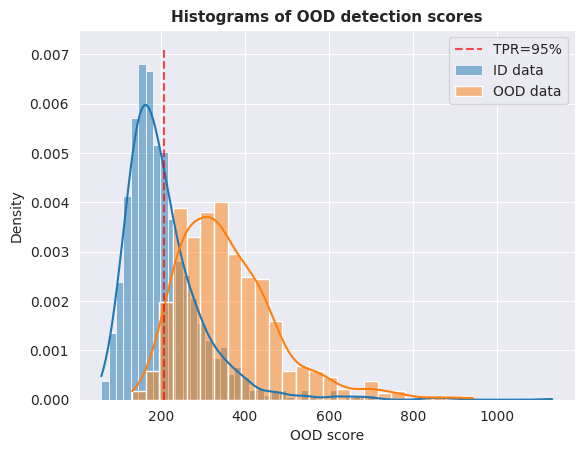

In [60]:
plot_ood_scores(scores_in, scores_out, log_scale=False)

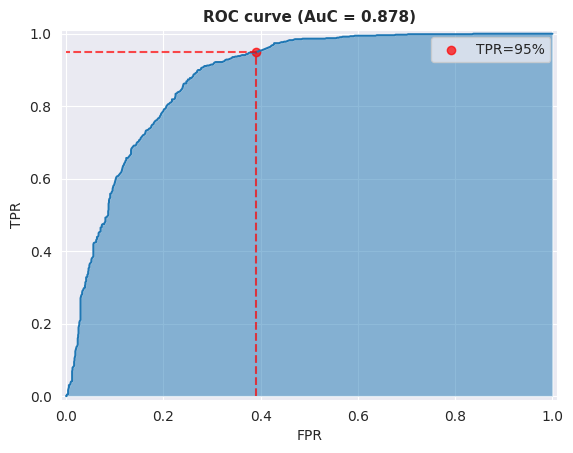

In [61]:
plot_roc_curve(scores_in, scores_out)